<a href="https://colab.research.google.com/github/AishaAlaagib/population-comparison/blob/main/Facebook_vs_Census.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Get the link to the dataset and copy data to your drive and mount to your drive

In [ ]:
# to obtain the data, open https://drive.google.com/drive/folders/1MQvvb-jawOH1Uui6linT4J42YVqH9LsA?usp=sharing
# and then click on Shared with me -> population_data -> data (down arrow) and click "Add shortcut to Drive" then click "ADD SHORTCUT"

In [ ]:
# the below will ask for permission, you should agree: 
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# go to the path in your drive where you copy the data above 
!cd drive/MyDrive/data/

/bin/bash: line 0: cd: /content/drive/data/: No such file or directory


In [ ]:
ls

all_data_together_by_specific_ages.csv
all_data_together.csv
censsus+facebook_by_specific_ages.csv
censu+facebook_tota.csv
census/
census_facebook_data_together.csv
census+facebook_female.csv
census+facebook_female.png
census+facebook_male.csv
census+facebook_male.png
census+facebook+world_male.csv
census_les_ages_2020.csv
census_les_female_all_states_ages_2020.csv
census_les_male_all_states_ages_200.csv
census_les_male_all_states_ages_2020.csv
census_les_states_ages_2020.csv
censu+worldpop+facebook_tota.csv
censu+worldpop+facebook_total.csv
facebook.csv
facebook_les_ages_2020.csv
lesotho-adm1-uscb-jun20.zip
les_world_2020.csv
lso_cencus_total_2020.csv
lso_fb_2020.csv
Meta/
worldpop/
worldpop+facebook.csv
worldpop_les_ages_2020.csv
worldpop_les_female_all_states_ages_2020.csv
worldpop_les_male_all_states_ages_2020.csv
worldpop_les_states_pop.csv


# Install and import *package*

In [ ]:
# install packeges

!pip install rasterio
!pip install swifter
!pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.1/20.1 MB 52.1 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 830.9/830.9 KB 17.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 280.2/280.2 KB 29.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 58.2 MB/s eta 0:00:00
  Created wheel for swifter: filename=swifter-1.3.4-py3-none-any.whl size=16321 sha256=5850631eba8a58fc4a9e99880082675414a7dec8a57ed0f82173dec476548bd2
  Stored in directory: /root/.cache/pip/wheels/2b/5e/f2/3931524f702ffd03309e96d35ee2fbf9c61c27377511ee8d4c
Successfully built swifter
  Attempting uninstall: psutil
    Found existing installation: psutil 5.4.8
    Uninstalling psutil-5.4.8:
      Successfully uninstalled psutil-5.4.8


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 17.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 38.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.7/7.7 MB 16.0 MB/s eta 0:00:00


In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
import pandas as pd
import pandas as pd
import matplotlib.pyplot as plt
import math
import seaborn as sns 
import imageio
import pandas as pd
import pathlib
import matplotlib.animation as animation
import matplotlib.pyplot as plt
import numpy as np
import rasterio
from rasterio import mask
from rasterio.plot import show,show_hist

import matplotlib.pyplot as plt
import plotly.express as px
import swifter

import geopandas as gpd
import numpy as np
import json

import shapely
from shapely.geometry import Polygon, Point
from shapely.ops import cascaded_union
import shapely.speedups

shapely.speedups.enable()

# Link to the Census, WorldPop and Facebook dataset for your references


1. link for Cencus data + lesotho bounderies

https://www2.census.gov/programs-surveys/international-programs/tables/time-series/pepfar/lesotho.xlsx
https://www2.census.gov/programs-surveys/international-programs/mapping-files/time-series/lesotho-adm1-uscb-jun20.zip

2. link for worlpop data

https://hub.worldpop.org/geodata/summary?id=50217

3. link for facebook data

https://data.humdata.org/m/dataset/highresolutionpopulationdensitymaps-lso




In [ ]:
# !wget https://data.humdata.org/dataset/30582cb9-dc92-45aa-88f8-5501fb748a31/resource/f167f18d-0a04-48d7-b76d-d2acf323f9ad/download/lso_general_2020_csv.zip
# !unzip lso_general_2020_csv.zip 
# !wget https://hub.worldpop.org/geodata/summary?id=50217

# Load the dataset




## Loading and Exploring Population Data in from census

Load the Lesotho administrative boundaries

In [ ]:
Lesotho_administrative_boundaries = gpd.read_file('census/lesotho-adm1-uscb-jun20/Lesotho_adm1_uscb_2020.shp')
Lesotho_administrative_boundaries

,Shape_Leng,Shape_Area,AREA_NAME,GEO_CONCAT,GEO_MATCH,CNTRY_NAME,ADM1_NAME,ADM_LEVEL,GENC_CODE,FIPS_CODE,NSO_CODE,geometry
0,3.364043,0.183431,BEREA,LESOTHO_BEREA,LSO_03,LESOTHO,BEREA,1,LS-D,LT10,3,"POLYGON ((27.98593 -28.94685, 27.98599 -28.946..."
1,2.613805,0.165235,BUTHA-BUTHE,LESOTHO_BUTHA-BUTHE,LSO_01,LESOTHO,BUTHA-BUTHE,1,LS-B,LT11,1,"POLYGON ((28.65142 -28.57057, 28.65145 -28.570..."
2,5.798481,0.261754,LERIBE,LESOTHO_LERIBE,LSO_02,LESOTHO,LERIBE,1,LS-C,LT12,2,"POLYGON ((28.18352 -28.69359, 28.18378 -28.693..."
3,3.640401,0.200510,MAFETENG,LESOTHO_MAFETENG,LSO_05,LESOTHO,MAFETENG,1,LS-E,LT13,5,"POLYGON ((27.27873 -29.52665, 27.27990 -29.527..."
4,5.316844,0.371898,MASERU,LESOTHO_MASERU,LSO_04,LESOTHO,MASERU,1,LS-A,LT14,4,"POLYGON ((27.50580 -29.28208, 27.50667 -29.282..."
5,5.694581,0.345687,MOHALE'S HOEK,LESOTHO_MOHALE'S HOEK,LSO_06,LESOTHO,MOHALE'S HOEK,1,LS-F,LT15,6,"POLYGON ((28.55848 -29.78321, 28.55900 -29.783..."
6,4.497314,0.386815,MOKHOTLONG,LESOTHO_MOKHOTLONG,LSO_09,LESOTHO,MOKHOTLONG,1,LS-J,LT16,9,"POLYGON ((28.85799 -28.75541, 28.85858 -28.755..."
7,3.617690,0.198658,QACHA'S NEK,LESOTHO_QACHA'S NEK,LSO_08,LESOTHO,QACHA'S NEK,1,LS-H,LT17,8,"POLYGON ((29.03196 -29.70939, 29.03351 -29.710..."
8,3.678044,0.279084,QUTHING,LESOTHO_QUTHING,LSO_07,LESOTHO,QUTHING,1,LS-G,LT18,7,"POLYGON ((28.25464 -30.02283, 28.25674 -30.022..."
9,6.244152,0.452519,THABA-TSEKA,LESOTHO_THABA-TSEKA,LSO_10,LESOTHO,THABA-TSEKA,1,LS-K,LT19,10,"POLYGON ((28.28211 -29.11906, 28.28301 -29.119..."


In [ ]:
Lesotho_administrative_boundaries['ADM1_NAME'].nunique()

10

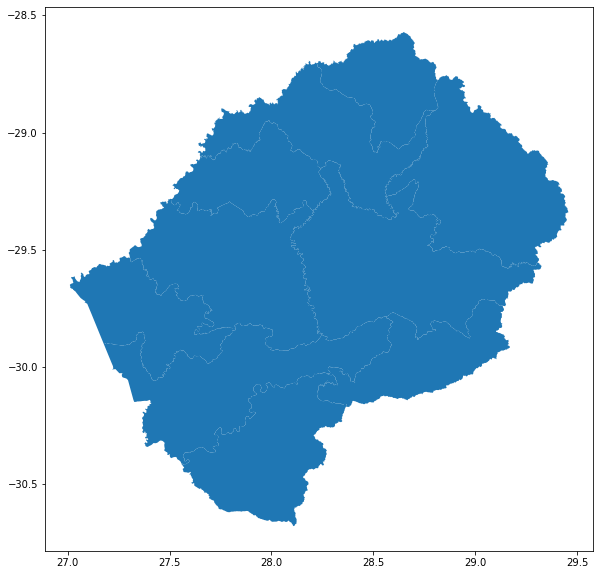

In [ ]:
fig, ax = plt.subplots(figsize = (10,10))
Lesotho_administrative_boundaries.plot(ax=ax)
plt.show()

In [ ]:
# Load the census data
import openpyxl

workbook = openpyxl.load_workbook(filename='census/lesotho.xlsx')

# Select the worksheet
worksheet = workbook['2000 - 2025']

# Read the data into a dataframe starting from row 4
data_rows = worksheet.iter_rows(min_row=5, values_only=True)
data = pd.DataFrame(data_rows, columns=[cell.value for cell in worksheet[4]],)
# data.to_excel('lesothon.xlsx')
# data.droplevel('Population estimates are rounded to the nearest whole number')
data

,AREA_NAME,GEO_CONCAT,GEO_MATCH,CNTRY_NAME,ADM1_NAME,ADM2_NAME,ADM3_NAME,ADM4_NAME,ADM_LEVEL,USCBCMNT,...,F3539_2025,F4044_2025,F4549_2025,F5054_2025,F5559_2025,F6064_2025,F6569_2025,F7074_2025,F7579_2025,F80PL_2025
0,LESOTHO,LESOTHO,LSO_00,LESOTHO,,,,,0,None,...,82259,73148,47432,25842,20559,20447,18433,14312,10586,12841
1,.BUTHA-BUTHE,LESOTHO_BUTHA-BUTHE,LSO_01,LESOTHO,BUTHA-BUTHE,,,,1,None,...,4577,4095,2736,1564,1235,1275,1141,966,605,779
2,.LERIBE,LESOTHO_LERIBE,LSO_02,LESOTHO,LERIBE,,,,1,None,...,14907,13279,8765,4635,3799,3682,3245,2494,1719,2196
3,.BEREA,LESOTHO_BEREA,LSO_03,LESOTHO,BEREA,,,,1,None,...,10658,9613,6673,3553,2839,2753,2366,1819,1346,1535
4,.MASERU,LESOTHO_MASERU,LSO_04,LESOTHO,MASERU,,,,1,None,...,27364,22890,13988,7038,5379,5120,4671,3332,2453,2695
5,.MAFETENG,LESOTHO_MAFETENG,LSO_05,LESOTHO,MAFETENG,,,,1,None,...,5747,5394,3574,2126,1807,1935,1706,1272,1004,1143
6,.MOHALE'S HOEK,LESOTHO_MOHALE'S HOEK,LSO_06,LESOTHO,MOHALE'S HOEK,,,,1,None,...,5147,4902,3437,2047,1659,1668,1585,1275,977,1239
7,.QUTHING,LESOTHO_QUTHING,LSO_07,LESOTHO,QUTHING,,,,1,None,...,3472,3218,2201,1334,1089,1135,1021,844,685,829
8,.QACHA'S NEK,LESOTHO_QACHA'S NEK,LSO_08,LESOTHO,QACHA'S NEK,,,,1,None,...,2656,2396,1600,924,759,730,722,548,439,639
9,.MOKHOTLONG,LESOTHO_MOKHOTLONG,LSO_09,LESOTHO,MOKHOTLONG,,,,1,None,...,3296,3135,1863,1111,811,909,811,727,511,700


In [ ]:
# define the age range we are going to use

age = ['0', '5' ,'10','15','20', '25', '30','35','40','45','50','55','60','65','70','75','80']

In [ ]:
# get the census total data for genral, male and femal
l = ['BTOTL_2020','FTOTL_2020','MTOTL_2020'].copy()
name =['geneal','women','man']
df_lesotho = data[data.columns.values[[1094,1130,1112]]]
df_lesotho = data[l].copy()
df_lesotho.columns = name
dm_level_d= data['AREA_NAME']
df_lesotho = pd.concat([dm_level_d, df_lesotho], axis = 1)
df_lesotho.to_csv('lso_cencus_total_2020.csv',index=False)
df_lesotho

,AREA_NAME,geneal,women,man
0,LESOTHO,1969334,994675,974659
1,.BUTHA-BUTHE,115861,58450,57411
2,.LERIBE,340670,172472,168198
3,.BEREA,255142,128587,126555
4,.MASERU,533235,275787,257448
5,.MAFETENG,164001,80531,83470
6,.MOHALE'S HOEK,153145,76436,76709
7,.QUTHING,106552,53173,53379
8,.QACHA'S NEK,72985,36703,36282
9,.MOKHOTLONG,96691,47995,48696


In [ ]:
# get the total for census data for all ages and districts
df_lesotho = data[data.columns.values[1095:1112]].copy()
df_lesotho.columns = age
dm_level_d= data['AREA_NAME']
df_lesotho = pd.concat([dm_level_d, df_lesotho], axis = 1)
df_lesotho.to_csv('census_les_states_ages_2020.csv',index=False)
df_lesotho

,AREA_NAME,0,5,10,15,20,25,30,35,40,45,50,55,60,65,70,75,80
0,LESOTHO,212838,204333,199141,196554,182772,179544,178757,164982,116436,69950,55555,52236,45931,36866,29261,20694,23484
1,.BUTHA-BUTHE,12649,12551,11974,11141,10238,10327,10418,9474,6689,4020,3381,3237,2848,2316,1899,1232,1467
2,.LERIBE,36205,35268,33673,33813,31413,31404,31504,28922,20279,12535,9752,9304,8007,6284,4921,3401,3985
3,.BEREA,27186,25866,24999,25163,23196,22763,23317,21724,15460,9808,7766,7441,6364,4763,3791,2712,2823
4,.MASERU,55812,49868,47902,50052,54512,54204,53746,50833,34532,19774,14498,12762,10838,8522,6315,4347,4718
5,.MAFETENG,17136,16592,17001,17034,14306,14256,14037,12898,9417,5714,4952,4987,4507,3962,2808,2082,2312
6,.MOHALE'S HOEK,16389,16335,16367,15607,13655,13152,12939,11406,8455,5291,4555,4529,4131,3356,2746,1945,2287
7,.QUTHING,11716,11478,11611,11253,9937,9405,9004,7727,5527,3469,3000,2874,2704,2196,1843,1368,1440
8,.QACHA'S NEK,8267,8154,8219,7897,6381,6193,6255,5499,3799,2329,1995,1935,1650,1392,1146,799,1075
9,.MOKHOTLONG,11523,11876,11925,10577,8316,7628,7564,7094,5198,2888,2373,2142,2044,1701,1501,1012,1329


In [ ]:
# get the census data for male including age and districts

df_lesotho_f = data[data.columns[1131:1148]].copy()
df_lesotho_f.columns = age
dm_level_d= data['AREA_NAME']
df_lesotho_f = pd.concat([dm_level_d, df_lesotho_f], axis = 1)
df_lesotho_f.to_csv('census_les_female_all_states_ages_2020.csv',index=False)
df_lesotho_f

,AREA_NAME,0,5,10,15,20,25,30,35,40,45,50,55,60,65,70,75,80
0,LESOTHO,105182,101358,99781,100626,96826,96986,95509,86104,56620,31654,25028,24195,21531,17004,13554,9885,12832
1,.BUTHA-BUTHE,6316,6370,6066,5851,5457,5487,5449,4826,3186,1833,1516,1454,1340,1051,912,562,774
2,.LERIBE,17911,17408,17057,17277,16759,17073,16896,15195,9991,5676,4344,4322,3743,2889,2276,1545,2110
3,.BEREA,13402,12889,12453,12911,12066,12270,12561,11378,7575,4527,3488,3382,2930,2206,1738,1266,1545
4,.MASERU,27558,24778,24032,26429,30246,30567,29730,27350,16885,8882,6467,6001,5103,4078,2982,2161,2538
5,.MAFETENG,8357,8166,8389,8424,7102,7241,7259,6539,4531,2584,2224,2296,2195,1695,1296,1007,1226
6,.MOHALE'S HOEK,8124,8100,8230,7794,7017,6877,6667,5818,4089,2469,2128,2092,1881,1566,1291,973,1320
7,.QUTHING,5772,5683,5720,5660,5138,4910,4626,3927,2686,1581,1387,1376,1279,1008,854,683,883
8,.QACHA'S NEK,4120,4006,4150,3945,3304,3331,3339,2797,1863,1071,895,891,767,664,517,408,635
9,.MOKHOTLONG,5655,5808,5996,5439,4315,3913,3883,3539,2484,1271,1096,973,972,761,699,483,708


In [ ]:
# get the census data for female including age and districts

df_lesotho_m = data[data.columns[1113:1130]].copy()
df_lesotho_m.columns = age
dm_level_d= data['AREA_NAME']
df_lesotho_m = pd.concat([dm_level_d, df_lesotho_m], axis = 1)
df_lesotho_m.to_csv('census_les_male_all_states_ages_2020.csv',index=False)
df_lesotho_m

,AREA_NAME,0,5,10,15,20,25,30,35,40,45,50,55,60,65,70,75,80
0,LESOTHO,107656,102975,99360,95928,85946,82558,83248,78878,59816,38296,30527,28041,24400,19862,15707,10809,10652
1,.BUTHA-BUTHE,6333,6181,5908,5290,4781,4840,4969,4648,3503,2187,1865,1783,1508,1265,987,670,693
2,.LERIBE,18294,17860,16616,16536,14654,14331,14608,13727,10288,6859,5408,4982,4264,3395,2645,1856,1875
3,.BEREA,13784,12977,12546,12252,11130,10493,10756,10346,7885,5281,4278,4059,3434,2557,2053,1446,1278
4,.MASERU,28254,25090,23870,23623,24266,23637,24016,23483,17647,10892,8031,6761,5735,4444,3333,2186,2180
5,.MAFETENG,8779,8426,8612,8610,7204,7015,6778,6359,4886,3130,2728,2691,2312,2267,1512,1075,1086
6,.MOHALE'S HOEK,8265,8235,8137,7813,6638,6275,6272,5588,4366,2822,2427,2437,2250,1790,1455,972,967
7,.QUTHING,5944,5795,5891,5593,4799,4495,4378,3800,2841,1888,1613,1498,1425,1188,989,685,557
8,.QACHA'S NEK,4147,4148,4069,3952,3077,2862,2916,2702,1936,1258,1100,1044,883,728,629,391,440
9,.MOKHOTLONG,5868,6068,5929,5138,4001,3715,3681,3555,2714,1617,1277,1169,1072,940,802,529,621


## Loading and Exploring Population Data in  Raster Format from worldpop

In [ ]:
%%time
Lesotho_worldpop_raster = rasterio.open('worldpop/lso_ppp_2020_UNadj_constrained.tif')
# Lesotho_worldpop_raster = rasterio.open(os_path_selected+'vnm_ppp_2020_constrained.tif')

print('No. of bands:',(Lesotho_worldpop_raster.count))
# Reading the first band, filtering negative raster values and visualise data with matplotlib
Lesotho_worldpop_raster_tot = Lesotho_worldpop_raster.read(1)
# Lesotho_worldpop_raster_tot[Lesotho_worldpop_raster_tot<0] = None
Lesotho_worldpop_raster_tot

No. of bands: 1
CPU times: user 113 ms, sys: 7.54 ms, total: 120 ms
Wall time: 145 ms


array([[-99999., -99999., -99999., ..., -99999., -99999., -99999.],
       [-99999., -99999., -99999., ..., -99999., -99999., -99999.],
       [-99999., -99999., -99999., ..., -99999., -99999., -99999.],
       ...,
       [-99999., -99999., -99999., ..., -99999., -99999., -99999.],
       [-99999., -99999., -99999., ..., -99999., -99999., -99999.],
       [-99999., -99999., -99999., ..., -99999., -99999., -99999.]],
      dtype=float32)

In [ ]:
def concat_polygon(geometry_list):
    polygons = geometry_list
    boundary = gpd.GeoSeries(cascaded_union(polygons))
    return(boundary)
def get_population_count(vector_polygon,raster_layer):
    gtraster, bound = rasterio.mask.mask(raster_layer, [vector_polygon], crop=True)
    pop_estimate = gtraster[0][gtraster[0]>0].sum()
    return (pop_estimate.round(2))

In [ ]:
Lesotho_worldpop_raster_tot = Lesotho_worldpop_raster.read(1)
Lesotho_worldpop_raster_tot[Lesotho_worldpop_raster_tot<0] = None

#Calculating total population of Lesotho 

worldpop_raster_nonzero = Lesotho_worldpop_raster_tot[Lesotho_worldpop_raster_tot>0]
population_worldpop = worldpop_raster_nonzero[worldpop_raster_nonzero > 0].sum()
print(round(population_worldpop/1000000,2),'million')

# l.append(population_worldpop)
Lesotho_administrative_boundaries['population_count_wp'] = Lesotho_administrative_boundaries['geometry'].apply(get_population_count,raster_layer=Lesotho_worldpop_raster)
Lesotho_administrative_boundaries['population_count_wp_million'] = round(Lesotho_administrative_boundaries['population_count_wp']/1000000,2)


# save each age to csv file 
adm_level_c = Lesotho_administrative_boundaries[['ADM1_NAME','population_count_wp']]#,'population_count_wp_million',]]#.round(1).reset_index()

adm_level_c.loc[10] = ['LESOTHO',adm_level_c['population_count_wp'].sum()]
adm_level_c = pd.concat([adm_level_c[-1:],adm_level_c[:10]])
 
adm_level_c.to_csv('data/worldpop_les_states_pop.csv',index=False)

adm_level_c


2.14 million


,ADM1_NAME,population_count_wp
10,LESOTHO,2.142050e+06
0,BEREA,3.201528e+05
1,BUTHA-BUTHE,1.252255e+05
2,LERIBE,3.144881e+05
3,MAFETENG,1.858036e+05
4,MASERU,5.268488e+05
5,MOHALE'S HOEK,1.828048e+05
6,MOKHOTLONG,1.298806e+05
7,QACHA'S NEK,7.959317e+04
8,QUTHING,1.333435e+05


In [ ]:
adm_level = Lesotho_administrative_boundaries[['AREA_NAME','population_count_wp_million','geometry']].round(1).reset_index()
adm_level['geometry'] = adm_level['geometry'].apply(lambda x:gpd.GeoSeries(x).to_json())

dept_geo = []

# Get data from dataset (using json.loads to transform string into dict for geoshape column)
cd_depts = adm_level['AREA_NAME'].tolist()
shapes = adm_level['geometry'].values

# Iterate over lines
for x in range(0,len(adm_level['geometry'].values),1):
    shape = json.loads(adm_level['geometry'].values[x])['features'][0]['geometry']
    # Mapping information from data to GeoJSON file
    dept_geo.append({
        'type': 'Feature',
        'geometry': shape,
        'id':cd_depts[x]
    })

# Encapsulate dept_geo in a real GeoJSON formatted file
dept_geo_ok = {'type': 'FeatureCollection', 'features': dept_geo}
# print(dept_geo_ok)
fig = px.choropleth(adm_level, geojson=dept_geo_ok, locations='AREA_NAME', color='population_count_wp_million',
                           color_continuous_scale="viridis",
                           range_color=(adm_level['population_count_wp_million'].min(), adm_level['population_count_wp_million'].max()),
                           labels={'population_count_wp_million':'Population WorldPop (Million)'}
                          )
fig.update_geos(fitbounds="locations", visible=False)

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()




### Save the WorldPop data in csv file inclusing all ages from 0-80 aggregate by 5, sex and for all Lesotho states

In [ ]:
dir = 'data/'

In [ ]:

# save the data for male, female, age
from csv import writer

for j in ['f','m']:
    adm_level_d= Lesotho_administrative_boundaries['ADM1_NAME']
    adm_level_d.loc[len(adm_level_d.index)] = 'Total'
    l = []
    l.append('LESOTHO')
    adm_level_d.to_csv(dir+'worldpop/worldpop_les_'+j+'_age_states_2020.csv',index=False)
    k = [p for p in range(0,85,5)]
    k.append(1)
    print(k)
    for i in k:
        Lesotho_worldpop_raster = rasterio.open(dir+'worldpop/lso_'+j+'_'+str(i)+'_2020_constrained.tif')
        # print('No. of bands:',(Lesotho_worldpop_raster.count))
        # Reading the first band, filtering negative raster values and visualise data with matplotlib
        Lesotho_worldpop_raster_tot = Lesotho_worldpop_raster.read(1)
        Lesotho_worldpop_raster_tot[Lesotho_worldpop_raster_tot<0] = None

        #Calculating total population of Lesotho 

        worldpop_raster_nonzero = Lesotho_worldpop_raster_tot[Lesotho_worldpop_raster_tot>0]
        population_worldpop = worldpop_raster_nonzero[worldpop_raster_nonzero > 0].sum()
        # print(round(population_worldpop/1000000,2),'million')
        l.append(population_worldpop)
        # print(l)
        Lesotho_administrative_boundaries['population_count_wp'] = Lesotho_administrative_boundaries['geometry'].apply(get_population_count,raster_layer=Lesotho_worldpop_raster)
        # Lesotho_administrative_boundaries['population_count_wp_million'] = round(Lesotho_administrative_boundaries['population_count_wp']/1000000,2)

        # save each age to csv file 
        adm_level_c = Lesotho_administrative_boundaries[['ADM1_NAME','population_count_wp']]#,'population_count_wp_million',]]#.round(1).reset_index()
        adm_level_c.to_csv('data/worldpop/worldpop_les_'+j+'_'+str(i)+'_states_pop.csv',index=False)
        
        
        
        #save all ages to one csv file 
        adm_level_d= Lesotho_administrative_boundaries[['population_count_wp']]
        adm_level_d.columns= [str(i)]
        # adm_level_d.loc[len(adm_level_d.index)] = ['Total',population_worldpop]
        csv_input = pd.read_csv(dir+'worldpop/worldpop_les_'+j+'_age_states_2020.csv')
        csv_input[str(i)] = adm_level_d[str(i)]
        # csv_input.loc[10] = [p for p in l]
        csv_input.to_csv(dir+'worldpop/worldpop_les_'+j+'_age_states_2020.csv', index=False)

    with open(dir+'worldpop/les_'+j+'_age_states_2020.csv','a') as f_object:
        writer_object = writer(f_object)
 
        # Pass the list as an argument into
        # the writerow()
        writer_object.writerow(l)

        # Close the file object
        f_object.close()
    csv_input.loc[len(adm_level_c.index)] = [p for p in l]
    # print(adm_level_d)
    csv_input.to_csv(dir+'worldpop/worldpop_les_'+j+'_age_states_2020.csv',index=False)
    if j == 'f':
        j='female'
    else:
        j='male'
    csv_input.to_csv(dir+'worldpop/worldpop_les_'+j+'_all_states_ages_2020.csv',index=False)
    csv_input.to_csv(dir+'worldpop_les_'+j+'_all_states_ages_2020.csv',index=False)

    # print(csv_input)


    

[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 1]
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 1]


In [ ]:
for j in ['female','male']:
    df = pd.read_csv(dir+'worldpop_les_'+j+'_all_states_ages_2020.csv')
    df['0'] = df['0'] +df['1']
    df = df[df.columns[0:18]].copy()
    df = pd.concat([df[-1:],df[:10]])
    df.to_csv(dir+'worldpop_les_'+j+'_all_states_ages_2020.csv',index=False)


In [ ]:
worldpop_tot = pd.read_csv(dir+'worldpop_les_states_pop.csv')

print(worldpop_tot)
wolrdpo_m = pd.read_csv(dir+'worldpop_les_male_all_states_ages_2020.csv')
wolrdpo_f = pd.read_csv(dir+'worldpop_les_female_all_states_ages_2020.csv')

worldpop_tot['women'] = wolrdpo_m.sum(axis=1)
worldpop_tot['man'] = wolrdpo_f.sum(axis=1)

worldpop_tot.columns.values[1] ='general'

worldpop_tot.to_csv(dir+'les_world_2020.csv',index=False)

        ADM1_NAME  population_count_wp
0         LESOTHO           2142050.20
1           BEREA            320152.75
2     BUTHA-BUTHE            125225.48
3          LERIBE            314488.10
4        MAFETENG            185803.60
5          MASERU            526848.75
6   MOHALE'S HOEK            182804.80
7      MOKHOTLONG            129880.64
8     QACHA'S NEK             79593.17
9         QUTHING            133343.52
10    THABA-TSEKA            143909.39


## Loading and Exploring Population Data in  Raster Format from Facebook

In [ ]:
# Lesotho_administrative_boundaries = gpd.read_file('data/census/lesotho-adm1-uscb-jun20/Lesotho_adm1_uscb_2020.shp')
# Lesotho_administrative_boundaries


In [ ]:
%%time
# Lesotho_meta_raster = rasterio.open('Meta/lso_general_2020_geotiff/lso_general_2020.tif')
# # Lesotho_worldpop_raster = rasterio.open(os_path_selected+'vnm_ppp_2020_constrained.tif')

# print('No. of bands:',(Lesotho_meta_raster.count))
# # Reading the first band, filtering negative raster values and visualise data with matplotlib
# Lesotho_meta_raster_tot = Lesotho_meta_raster.read(1)
# # Lesotho_meta_raster_tot[Lesotho_meta_raster_tot<0] = None
# Lesotho_meta_raster_tot 
# # plt.rcParams['figure.figsize'] = 14, 14
# # plt.imshow(np.log10(Lesotho_worldpop_raster_tot+1),)
# # bar = plt.colorbar(fraction=0.5)

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 8.11 µs


In [ ]:
# meta_raster_nonzero = Lesotho_meta_raster_tot[Lesotho_meta_raster_tot>0]
# population_meta = meta_raster_nonzero[meta_raster_nonzero > 0].sum()
# print(round(population_meta/1000000,2),'million')

In [ ]:
facebook_data_latest = pd.read_csv('Meta/lso_general_2020_csv/lso_general_2020.csv')
print(facebook_data_latest.head())

   longitude   latitude  lso_general_2020
0  27.072083 -27.999861          0.247126
1  27.072361 -27.999861          0.247126
2  27.072639 -27.999861          0.247126
3  27.072917 -27.999861          0.247126
4  27.073194 -27.999861          0.247126



In order to use the geospatial tools and techniques demonstrated with WorldPop data, we need to convert this dataframe into a geodataframe which includes a geometry field.

In [ ]:
%%time
def convert_Point(facebook_data_latest):
    return Point(facebook_data_latest['longitude'],facebook_data_latest['latitude'])
facebook_data_latest['geometry'] = facebook_data_latest[['latitude','longitude']].apply(convert_Point,axis=1)
facebook_data_latest = gpd.GeoDataFrame(facebook_data_latest) 

CPU times: user 1min 53s, sys: 2.73 s, total: 1min 56s
Wall time: 2min 18s


In [ ]:
facebook_data_latest

,longitude,latitude,lso_women_2020,geometry
0,27.072083,-27.999861,0.111599,POINT (27.07208 -27.99986)
1,27.072361,-27.999861,0.111599,POINT (27.07236 -27.99986)
2,27.072639,-27.999861,0.111599,POINT (27.07264 -27.99986)
3,27.072917,-27.999861,0.111599,POINT (27.07292 -27.99986)
4,27.073194,-27.999861,0.111599,POINT (27.07319 -27.99986)
...,...,...,...,...
3122337,29.901806,-30.999583,0.653789,POINT (29.90181 -30.99958)
3122338,29.902083,-30.999583,0.653789,POINT (29.90208 -30.99958)
3122339,29.911806,-30.999583,0.722871,POINT (29.91181 -30.99958)
3122340,29.912083,-30.999583,0.722871,POINT (29.91208 -30.99958)


We then get the population counts per administrative boundaries with the masking function for the vector layer with a polygon.

In [ ]:
def get_population_count_vector(vector_polygon,vector_layer):
    pip_mask = vector_layer.within(vector_polygon)
    pip_data = vector_layer.loc[pip_mask]
    population_total = round(pip_data['lso_general_2020'].sum(),2)
    print(population_total)
    return(population_total)

In [ ]:
%%time
# Lesotho_administrative_boundaries['population_count_fb'] = Lesotho_administrative_boundaries['geometry'].apply(get_population_count,raster_layer=facebook_data_latest)
# Lesotho_administrative_boundaries['population_count_fb_million'] = round(Lesotho_administrative_boundaries['population_count_fb']/1000000,2)
#%%time
Lesotho_administrative_boundaries['population_count_fb'] = Lesotho_administrative_boundaries['geometry'].apply(get_population_count_vector,vector_layer=facebook_data_latest)
Lesotho_administrative_boundaries['population_count_fb_million'] = round(Lesotho_administrative_boundaries['population_count_fb']/1000000,2)


18072.37
145862.97
367212.89
216984.95
614827.54
213019.02
151426.8
92766.27
157098.56
167848.86
CPU times: user 36min 33s, sys: 3.35 s, total: 36min 37s
Wall time: 39min 49s


In [ ]:
print(round(Lesotho_administrative_boundaries['population_count_fb'].sum()/1000000,2),',milion')
# print(round(population_meta/1000000,2),'million')

2.15 ,milion


We then plot the choropleth map with Plotly using the code below

In [ ]:
adm_level = Lesotho_administrative_boundaries[['ADM1_NAME','population_count_fb_million','geometry']].round(1).reset_index()
adm_level['geometry'] = adm_level['geometry'].apply(lambda x:gpd.GeoSeries(x).to_json())

# Instantiate list of features
dept_geo = []

# Get data from dataset (using json.loads to transform string into dict for geoshape column)
cd_depts = adm_level['ADM1_NAME'].tolist()
shapes = adm_level['geometry'].values

# Iterate over lines
for x in range(0,len(adm_level['geometry'].values),1):
    shape = json.loads(adm_level['geometry'].values[x])['features'][0]['geometry']
    # Mapping information from data to GeoJSON file
    dept_geo.append({
        'type': 'Feature',
        'geometry': shape,
        'id':cd_depts[x]
    })

# Encapsulate dept_geo in a real GeoJSON formatted file
dept_geo_ok = {'type': 'FeatureCollection', 'features': dept_geo}

adm_level = adm_level[['ADM1_NAME','population_count_fb_million']]#,'population_count_wp_million']]

fig = px.choropleth(adm_level, geojson=dept_geo_ok, locations='ADM1_NAME', color='population_count_fb_million',
                           color_continuous_scale="viridis",
                           range_color=(adm_level['population_count_fb_million'].min()), #adm_level['population_count_wp_million'].max()),
                           labels={'population_count_fb_million':'Population (Million)'}
                          )
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()



# Comparing Facebook vs census

With the two mapping layers now previewed in a JPNE, we now turn to compare results through the more familiar administrative definitions lens familiar to most policymakers. To do this, we can visualize comparative ratios of Worldpop versus Facebook results with the scatterplots presented below.

In [ ]:
#define function to swap rows
def swap_rows(df, row1, row2):
    df.iloc[row1], df.iloc[row2] =  df.iloc[row2].copy(), df.iloc[row1].copy()
    return df

#swap rows in index positions 0 and 4
results = swap_rows(results, 0, 10)
results

,ADM1_NAME,population_count_fb_million
0,LESOTHO,2.15
1,BUTHA-BUTHE,0.15
2,LERIBE,0.37
3,MAFETENG,0.22
4,MASERU,0.61
5,MOHALE'S HOEK,0.21
6,MOKHOTLONG,0.15
7,QACHA'S NEK,0.09
8,QUTHING,0.16
9,THABA-TSEKA,0.17


In [ ]:
results = Lesotho_administrative_boundaries[['ADM1_NAME','population_count_fb_million']]
results.loc[10] = ['LESOTHO',results['population_count_fb_million'].sum()]
results = swap_rows(results, 0, 10)
results

In [ ]:

results['population_count_census_million'] = round(data['BTOTL_2020']/1000000,2)
results.to_csv('censu+facebook_million.csv',index=False)
results 

,ADM1_NAME,population_count_fb_million,population_count_census_million
0,LESOTHO,2.15,1.97
1,BUTHA-BUTHE,0.15,0.12
2,LERIBE,0.37,0.34
3,MAFETENG,0.22,0.26
4,MASERU,0.61,0.53
5,MOHALE'S HOEK,0.21,0.16
6,MOKHOTLONG,0.15,0.15
7,QACHA'S NEK,0.09,0.11
8,QUTHING,0.16,0.07
9,THABA-TSEKA,0.17,0.10


In [ ]:
# save facebook and census data for all the states
results = Lesotho_administrative_boundaries[['ADM1_NAME','population_count_fb']]
results.loc[10] = ['LESOTHO',results['population_count_fb'].sum()]
results = swap_rows(results, 0, 10)
results['population_count_census'] = data['BTOTL_2020']
results.to_csv('censu+facebook.csv',index=False)
results


,ADM1_NAME,population_count_fb,population_count_census
0,LESOTHO,2145120.23,1969334
1,BUTHA-BUTHE,145862.97,115861
2,LERIBE,367212.89,340670
3,MAFETENG,216984.95,255142
4,MASERU,614827.54,533235
5,MOHALE'S HOEK,213019.02,164001
6,MOKHOTLONG,151426.80,153145
7,QACHA'S NEK,92766.27,106552
8,QUTHING,157098.56,72985
9,THABA-TSEKA,167848.86,96691


In [ ]:
results = pd.read_csv('censu+facebook_million.csv')

fig = px.scatter(results,x='population_count_census_million',y='population_count_fb_million',
                 color='ADM1_NAME',
                 #color_discrete_sequence=px.colors.qualitative.Set2,
                 labels={'population_count_census_million':'Census Population Count (Millions)', 
                         'population_count_fb_million':'Facebook Population Count (Millions)'})

fig.update_layout(paper_bgcolor='white')
fig.update_layout(plot_bgcolor='white')


### Exploring the Facebook data for gender male and female


In [ ]:
def get_population_count_vector(vector_polygon,vector_layer,j):
    pip_mask = vector_layer.within(vector_polygon)
    pip_data = vector_layer.loc[pip_mask]
    population_total = round(pip_data['lso_'+j+'_2020'].sum(),2)
    print(population_total)
    return(population_total)

In [ ]:
from csv import writer

# for j in ['f','m']:
adm_level_d= Lesotho_administrative_boundaries['ADM1_NAME']
#     # adm_level_d.loc[len(adm_level_d.index)] = 'Total'
#     l = []
#     l.append('lesotho')
adm_level_d.to_csv('Meta/lso_fb_2020.csv',index=False)
for i in ['general','women','men']:
    Lesotho_worldpop_raster = rasterio.open('Meta/lso_'+i+'_2020_geotiff/lso_'+i+'_2020.tif') 
    print('No. of bands:',(Lesotho_worldpop_raster.count))
    # Reading the first band, filtering negative raster values and visualise data with matplotlib
    Lesotho_worldpop_raster_tot = Lesotho_worldpop_raster.read(1)
    Lesotho_worldpop_raster_tot[Lesotho_worldpop_raster_tot<0] = None
    # facebook_data_latest = pd.read_csv('Meta/lso_'+i+'_2020_csv/lso_'+i+'_2020.csv')
    # facebook_data_latest['geometry'] = facebook_data_latest[['latitude','longitude']].apply(convert_Point,axis=1)
    # facebook_data_latest = gpd.GeoDataFrame(facebook_data_latest) 

    #Calculating total population of Lesotho 

    worldpop_raster_nonzero = Lesotho_worldpop_raster_tot[Lesotho_worldpop_raster_tot>0]
    population_worldpop = worldpop_raster_nonzero[worldpop_raster_nonzero > 0].sum()
    print(round(population_worldpop/1000000,2),'million')
    l.append(population_worldpop)
    Lesotho_administrative_boundaries['population_count_wp'] = Lesotho_administrative_boundaries['geometry'].apply(get_population_count,raster_layer=Lesotho_worldpop_raster)
    Lesotho_administrative_boundaries['population_count_wp_million'] = round(Lesotho_administrative_boundaries['population_count_wp']/1000000,2)

    # Lesotho_administrative_boundaries['population_count_fb'] = Lesotho_administrative_boundaries['geometry'].apply(get_population_count_vector,vector_layer=facebook_data_latest,j = i)
    # Lesotho_administrative_boundaries['population_count_fb_million'] = round(Lesotho_administrative_boundaries['population_count_fb']/1000000,2)
    # l.append( Lesotho_administrative_boundaries['population_count_fb'].sum())

    # save each age to csv file 
    adm_level_c = Lesotho_administrative_boundaries[['ADM1_NAME','population_count_fb_million']]#,'population_count_wp_million',]]#.round(1).reset_index()
    adm_level_c.to_csv('Meta/lso_fb_'+str(i)+'_states_pop.csv',index=False)
    


#     #save all ages to one csv file 
    adm_level_d= Lesotho_administrative_boundaries[['population_count_fb']]
    adm_level_d.columns= [str(i)]
    # print(adm_level_c)
    # adm_level_d.loc[len(adm_level_d.index)] = ['Total',population_worldpop]
    csv_input = pd.read_csv('Meta/lso_fb_2020.csv')
    csv_input[str(i)] = adm_level_d[str(i)]

    csv_input.to_csv('Meta/lso_fb_2020.csv', index=False)

results = pd.read_csv('Meta/lso_fb_2020.csv')
results.loc[10] = ['LESOTHO',results['general'].sum(),results['women'].sum(),results['men'].sum()]
results = pd.concat([results[-1:],results[:10]])
results.to_csv('lso_fb_2020.csv', index=False)
   

18072.37
145862.97
367212.89
216984.95
614827.54
213019.02
151426.8
92766.27
157098.56
167848.86
9529.35
73763.37
188280.72
109387.49
321733.09
108725.85
76629.0
48508.12
80733.53
84807.37
8543.02
72099.58
178932.2
107597.47
293094.41
104293.18
74797.8
44258.14
76365.02
83041.48


In [ ]:
Lesotho_administrative_boundaries

,Shape_Leng,Shape_Area,AREA_NAME,GEO_CONCAT,GEO_MATCH,CNTRY_NAME,ADM1_NAME,ADM_LEVEL,GENC_CODE,FIPS_CODE,NSO_CODE,geometry,population_count_fb,population_count_fb_million
0,3.364043,0.183431,BEREA,LESOTHO_BEREA,LSO_03,LESOTHO,BEREA,1,LS-D,LT10,3,"POLYGON ((27.98593 -28.94685, 27.98599 -28.946...",18072.37,0.02
1,2.613805,0.165235,BUTHA-BUTHE,LESOTHO_BUTHA-BUTHE,LSO_01,LESOTHO,BUTHA-BUTHE,1,LS-B,LT11,1,"POLYGON ((28.65142 -28.57057, 28.65145 -28.570...",145862.97,0.15
2,5.798481,0.261754,LERIBE,LESOTHO_LERIBE,LSO_02,LESOTHO,LERIBE,1,LS-C,LT12,2,"POLYGON ((28.18352 -28.69359, 28.18378 -28.693...",367212.89,0.37
3,3.640401,0.200510,MAFETENG,LESOTHO_MAFETENG,LSO_05,LESOTHO,MAFETENG,1,LS-E,LT13,5,"POLYGON ((27.27873 -29.52665, 27.27990 -29.527...",216984.95,0.22
4,5.316844,0.371898,MASERU,LESOTHO_MASERU,LSO_04,LESOTHO,MASERU,1,LS-A,LT14,4,"POLYGON ((27.50580 -29.28208, 27.50667 -29.282...",614827.54,0.61
5,5.694581,0.345687,MOHALE'S HOEK,LESOTHO_MOHALE'S HOEK,LSO_06,LESOTHO,MOHALE'S HOEK,1,LS-F,LT15,6,"POLYGON ((28.55848 -29.78321, 28.55900 -29.783...",213019.02,0.21
6,4.497314,0.386815,MOKHOTLONG,LESOTHO_MOKHOTLONG,LSO_09,LESOTHO,MOKHOTLONG,1,LS-J,LT16,9,"POLYGON ((28.85799 -28.75541, 28.85858 -28.755...",151426.80,0.15
7,3.617690,0.198658,QACHA'S NEK,LESOTHO_QACHA'S NEK,LSO_08,LESOTHO,QACHA'S NEK,1,LS-H,LT17,8,"POLYGON ((29.03196 -29.70939, 29.03351 -29.710...",92766.27,0.09
8,3.678044,0.279084,QUTHING,LESOTHO_QUTHING,LSO_07,LESOTHO,QUTHING,1,LS-G,LT18,7,"POLYGON ((28.25464 -30.02283, 28.25674 -30.022...",157098.56,0.16
9,6.244152,0.452519,THABA-TSEKA,LESOTHO_THABA-TSEKA,LSO_10,LESOTHO,THABA-TSEKA,1,LS-K,LT19,10,"POLYGON ((28.28211 -29.11906, 28.28301 -29.119...",167848.86,0.17


### Exploring Facebook and Census data for specific age to use for comparison 






In [ ]:
from csv import writer

# for j in ['f','m']:
adm_level_d= Lesotho_administrative_boundaries['ADM1_NAME']
#     # adm_level_d.loc[len(adm_level_d.index)] = 'Total'
#     l = []
#     l.append('lesotho')
adm_level_d.to_csv('Meta/facebook_les_ages_2020.csv',index=False)
# for i in ['general','women','men']:
for i in ['children_under_five','youth_15_24','elderly_60_plus']:
    Lesotho_worldpop_raster = rasterio.open('Meta/lso_'+i+'_2020_geotiff/lso_'+i+'_2020.tif') 
    # print('No. of bands:',(Lesotho_worldpop_raster.count))
    # Reading the first band, filtering negative raster values and visualise data with matplotlib
    Lesotho_worldpop_raster_tot = Lesotho_worldpop_raster.read(1)
    Lesotho_worldpop_raster_tot[Lesotho_worldpop_raster_tot<0] = None

    #Calculating total population of Lesotho 

    worldpop_raster_nonzero = Lesotho_worldpop_raster_tot[Lesotho_worldpop_raster_tot>0]
    population_worldpop = worldpop_raster_nonzero[worldpop_raster_nonzero > 0].sum()
    print(round(population_worldpop/1000000,2),'million')
    l.append(population_worldpop)
    Lesotho_administrative_boundaries['population_count_wp'] = Lesotho_administrative_boundaries['geometry'].apply(get_population_count,raster_layer=Lesotho_worldpop_raster)
    Lesotho_administrative_boundaries['population_count_wp_million'] = round(Lesotho_administrative_boundaries['population_count_wp']/1000000,2)

    # save each age to csv file 
    adm_level_c = Lesotho_administrative_boundaries[['ADM1_NAME','population_count_wp_million']]#,'population_count_wp_million',]]#.round(1).reset_index()
    # adm_level_c.to_csv(os_path_selected+'worldpop/lso_f_'+str(i)+'_states_pop.csv',index=False)
    


#     #save all ages to one csv file 
    adm_level_d= Lesotho_administrative_boundaries[['population_count_wp']]
    adm_level_d.columns= [str(i)]
    # print(adm_level_c)
    # adm_level_d.loc[len(adm_level_d.index)] = ['Total',population_worldpop]
    csv_input = pd.read_csv('Meta/facebook_les_ages_2020.csv')
    csv_input[str(i)] = adm_level_d[str(i)]

    csv_input.to_csv('Meta/facebook_les_ages_2020.csv', index=False)
results = pd.read_csv('Meta/facebook_les_ages_2020.csv')
results.loc[10] = ['LESOTHO',results['children_under_five'].sum(),results['youth_15_24'].sum(),results['elderly_60_plus'].sum()]
results = pd.concat([results[-1:],results[:10]])
results.to_csv('Meta/facebook_les_ages_2020.csv', index=False)
results.to_csv('facebook_les_ages_2020.csv', index=False)


## Get all the data together and compare them

In [ ]:
#combine all the data in one file
dir = 'data/'
df_f = pd.read_csv('census_les_female_all_states_ages_2020.csv')
column =['data_source','region','sex','age','population']
age = df_f.columns[1:]
status = df_f['AREA_NAME']
d = []
for data in ['census']:
  year ='2020'
  for idx, k in enumerate(status):
      for j in ['female','male']:
          df_f = pd.read_csv(data+'_les_'+j+'_all_states_ages_'+year+'.csv') 
          for i in range(17):
              
              l = [ data, k, j, age[i],df_f.iat[idx, i+1]]
              # print(l)

              d.append(l)

for idx, k in enumerate(status):
    fb = pd.read_csv('lso_fb_2020.csv')

    for j in ['women','men']:

        df_f = fb[j][idx]
        if j =='women':
            j = 'female'
        else:
            j = 'male'
        d.append(['facebook', k,j,'allages',df_f])
x = pd.DataFrame(d, columns= column)

x.to_csv('census_facebook_data_together.csv',index=False)

In [ ]:
# !pip install plotnine
from plotnine.data import economics
from plotnine import ggplot, aes, geom_line, geom_col,theme_minimal,scale_x_continuous

In [ ]:
df = pd.read_csv('census_facebook_data_together.csv')
df

,data_source,region,sex,age,population
0,census,LESOTHO,female,0,105182.00
1,census,LESOTHO,female,5,101358.00
2,census,LESOTHO,female,10,99781.00
3,census,LESOTHO,female,15,100626.00
4,census,LESOTHO,female,20,96826.00
...,...,...,...,...,...
391,facebook,.QACHA'S NEK,male,allages,44243.76
392,facebook,.MOKHOTLONG,female,allages,80735.76
393,facebook,.MOKHOTLONG,male,allages,76366.96
394,facebook,.THABA-TSEKA,female,allages,84816.97


## Get all the data together and compare it for spacific age as it represented in Facebook

In [ ]:
fb = pd.read_csv('facebook_les_ages_2020.csv')
census = pd.read_csv('census_les_states_ages_2020.csv')

fb

,ADM1_NAME,children_under_five,youth_15_24,elderly_60_plus
0,LESOTHO,233385.09,505863.66,165389.48
1,BEREA,1833.24,4331.45,1259.41
2,BUTHA-BUTHE,15788.51,34634.40,11211.13
3,LERIBE,38722.45,86955.71,28280.16
4,MAFETENG,22381.40,53320.21,18523.63
5,MASERU,61462.73,149906.93,40058.49
6,MOHALE'S HOEK,23763.89,50275.03,18633.22
7,MOKHOTLONG,20139.79,33198.10,11840.14
8,QACHA'S NEK,10582.78,21229.72,7640.28
9,QUTHING,16979.38,36267.21,13818.37


In [ ]:

census['children_under_five'] = census.iloc[:,1:3].sum(axis=1)
census['youth_15_24'] = census.iloc[:,4:7].sum(axis=1)
census['elderly_60_plus'] = census.iloc[:,13:].sum(axis=1)
census = pd.concat([fb['ADM1_NAME'],census.iloc[:,18:]],axis=1)

census.to_csv('census_les_ages_2020.csv',index=False)

In [ ]:
#save all together

#combine all the data in one file
df_f = pd.read_csv('census_les_ages_2020.csv')
column =['data_source','region','age','population']
age = df_f.columns[1:]
# print(age)
status = df_f['ADM1_NAME']
d = []
for data in ['census','facebook']:
  for idx, k in enumerate(status):
    
    df_f = pd.read_csv(data+'_les_ages_2020.csv')
    for i in range(3):
      # print(l)
      l = [ data, k, age[i],df_f.iat[idx, i+1]]
      # print(l)

      d.append(l)

x = pd.DataFrame(d, columns= column)
x
x.to_csv('censsus+facebook_by_specific_ages.csv',index=False)
x

,data_source,region,age,population
0,census,LESOTHO,children_under_five,417171.00
1,census,LESOTHO,youth_15_24,558870.00
2,census,LESOTHO,elderly_60_plus,1132277.00
3,census,BEREA,children_under_five,25200.00
4,census,BEREA,youth_15_24,31706.00
...,...,...,...,...
61,facebook,QUTHING,youth_15_24,36267.21
62,facebook,QUTHING,elderly_60_plus,13818.37
63,facebook,THABA-TSEKA,children_under_five,21730.92
64,facebook,THABA-TSEKA,youth_15_24,35744.90


# Compare the two datasets

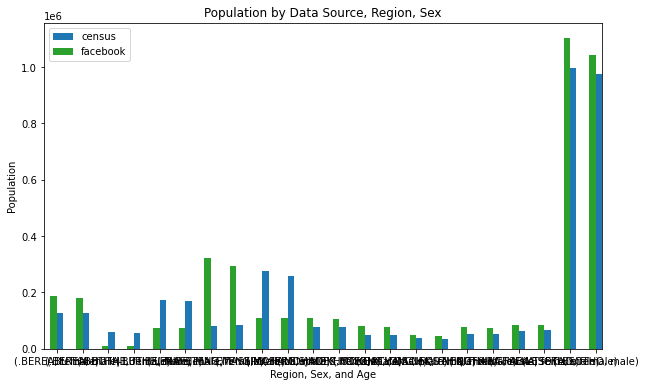

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load data into a pandas DataFrame
# df = pd.read_csv('population_data.csv')

# Create a pivot table to aggregate population by data source, region, sex, and age
pivot = pd.pivot_table(df, values='population', index=['data_source', 'region', 'sex', 'age'], aggfunc='sum')

# Reset the index to make the pivot table easier to work with
pivot = pivot.reset_index()

# Create a stacked bar chart
fig, ax = plt.subplots(figsize=(10, 6))

# Create a color map to assign colors to each data source
colors = {'census': '#1f77b4', 'facebook': '#2ca02c'}

# Iterate over the data sources and add a stacked bar for each one
for i, data_source in enumerate(pivot['data_source'].unique()):
    temp_df = pivot[pivot['data_source'] == data_source]
    pivot_region_sex_age = pd.pivot_table(temp_df, values='population', index=['region', 'sex'], aggfunc='sum')
    pivot_region_sex_age.plot(kind='bar', stacked=True, ax=ax, color=colors[data_source], position=i, width=0.25, rot=0)

# Set the title and axis labels
ax.set_title('Population by Data Source, Region, Sex')
ax.set_xlabel('Region, Sex, and Age')
ax.set_ylabel('Population')
ax.legend(pivot['data_source'].unique())

plt.show()


In [ ]:
import pandas as pd
import plotly.express as px

# Load data into a pandas DataFrame
# df = pd.read_csv('population_data.csv')

# Create a sunburst chart
fig = px.sunburst(df, path=['data_source', 'region', 'sex', 'age'], values='population')

# Customize the layout
# fig.update_layout(title='Population by Data Source, Region, Sex, and Age')

fig.update_layout(width=800, height=600,title='Population by Data Source, Region, Sex, and Age')

# Show the interactive plot
fig.show()


In [ ]:
adm_level = pd.read_csv('censu+facebook_million.csv')
# adm_level = adm_level[1:]
adm_level = swap_rows(adm_level,0,10)
# adm_level.rest_index()
adm_level = adm_level[:-1]
adm_level

,ADM1_NAME,population_count_fb_million,population_count_census_million
0,BEREA,0.02,0.13
1,BUTHA-BUTHE,0.15,0.12
2,LERIBE,0.37,0.34
3,MAFETENG,0.22,0.26
4,MASERU,0.61,0.53
5,MOHALE'S HOEK,0.21,0.16
6,MOKHOTLONG,0.15,0.15
7,QACHA'S NEK,0.09,0.11
8,QUTHING,0.16,0.07
9,THABA-TSEKA,0.17,0.10


In [ ]:
# wf = Lesotho_administrative_boundaries[['geometry']].round(1)
# wf['population_count_fb_million'] = adm_level['population_count_fb_million']
# wf

In [ ]:
# adm_level = pd.read_csv('censu+facebook_million.csv')
# adm_level = adm_level[1:]
wf = Lesotho_administrative_boundaries[['geometry']].round(1).reset_index()
adm_level['geometry'] = wf['geometry'].apply(lambda x:gpd.GeoSeries(x).to_json())
# Instantiate list of features
dept_geo = []

# Get data from dataset (using json.loads to transform string into dict for geoshape column)
cd_depts = adm_level['ADM1_NAME'].tolist()
shapes = adm_level['geometry'].values
# print(adm_level)

# Iterate over lines
for x in range(0,len(adm_level['geometry'].values),1):
    # print(adm_level['geometry'].values[x])
    shape = json.loads(adm_level['geometry'].values[x])['features'][0]['geometry']
    # Mapping information from data to GeoJSON file
    dept_geo.append({
        'type': 'Feature',
        'geometry': shape,
        'id':cd_depts[x]
    })

# Encapsulate dept_geo in a real GeoJSON formatted file
dept_geo_ok = {'type': 'FeatureCollection', 'features': dept_geo}

adm_level = adm_level[['ADM1_NAME','population_count_fb_million','population_count_census_million']]

fig = px.choropleth(adm_level, geojson=dept_geo_ok, locations='ADM1_NAME', color='ADM1_NAME',
                           color_continuous_scale="viridis",
                           range_color=(adm_level['population_count_fb_million'].min(), adm_level['population_count_census_million'].max()),
                           labels={'population_count_census_million':'Population census (Million)'},
                           hover_data=['population_count_census_million', 'population_count_fb_million'],
                           # hover_name='ADM1_NAME',
                           # text=adm_level['population_count_wp_million']
                          )
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()



Get male and female for the 3 datasets

In [ ]:
census = pd.read_csv('lso_cencus_total_2020.csv')
# worldpop = pd.read_csv('data/lso_fb_2020.csv')
faceook = pd.read_csv('lso_fb_2020.csv')
faceook[['ADM1_NAME','men']]

,ADM1_NAME,men
0,LESOTHO,1043013.01
1,BEREA,8501.19
2,BUTHA-BUTHE,72117.87
3,LERIBE,178895.04
4,MAFETENG,107592.02
5,MASERU,293134.11
6,MOHALE'S HOEK,104320.57
7,MOKHOTLONG,74790.69
8,QACHA'S NEK,44243.76
9,QUTHING,76366.96


In [ ]:
census = pd.read_csv('lso_cencus_total_2020.csv')
# worldpop = pd.read_csv('data/lso_fb_2020.csv')
fb = pd.read_csv('lso_fb_2020.csv')


# world_male= worldpop[['ADM1_NAME','men']]
fb_male= fb[['ADM1_NAME','men']]
fb_male['census_male']  = census['man']
fb_male.columns.values[1] = 'fb_male'

# world_male['fb_male'] = fb_male
# fb_male['census_male'] = census_male

fb_male.to_csv('census+facebook_male.csv',index=False)


# world_female= worldpop[['ADM1_NAME','women']]
fb_female = fb[['ADM1_NAME','women']]
fb_female['census_female'] = census['women'] 
fb_female.columns.values[1] = 'fb_femle'

# world_female['fb_female'] = fb_female
# fb_female['census_female'] = census['women'] 

fb_female.to_csv('census+facebook_female.csv',index=False)


In [ ]:
fb_female


,ADM1_NAME,fb_femle,census_female
0,LESOTHO,1102087.35,994675
1,BEREA,9480.59,58450
2,BUTHA-BUTHE,73782.51,172472
3,LERIBE,188240.89,128587
4,MAFETENG,109381.69,275787
5,MASERU,321781.93,80531
6,MOHALE'S HOEK,108753.53,76436
7,MOKHOTLONG,76621.53,53173
8,QACHA'S NEK,48491.95,36703
9,QUTHING,80735.76,47995


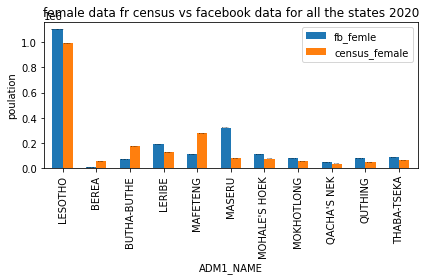

In [ ]:
wf_mf= pd.read_csv('census+facebook_female.csv')
wf_mf
ax = wf_mf.plot.bar(x='ADM1_NAME', title='female data fr census vs facebook data for all the states 2020' , width=.6)
ax.set_ylabel('poulation')
for container in ax.containers:
    ax.bar_label(container, fontsize=2)
# plt.figure(figsize=(14,40))

plt.tight_layout()
plt.savefig('census+facebook_female')
plt.show()

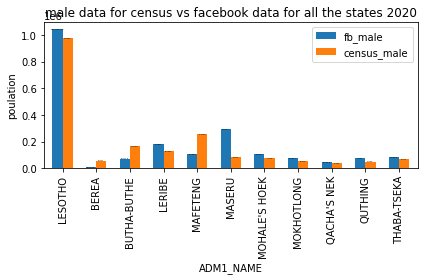

In [ ]:
wf_m= pd.read_csv('census+facebook_male.csv')
wf_m

ax = wf_m.plot.bar(x='ADM1_NAME', title='male data for census vs facebook data for all the states 2020' , width=.6)
ax.set_ylabel('poulation')

for container in ax.containers:
    ax.bar_label(container, fontsize=2)
# plt.figure(figsize=(14,40))

plt.tight_layout()
plt.savefig('census+facebook_male')
plt.show()